# all_sky_photometry
<pre>
Third step for all-sky calibration. 
This version reads with the RGB images (as FITS files) and uses
the astrometry obtained by all_sky_astrometry_V4-RGB.ipynb	
These images are corrected from vignetting.

based in Jia Yin et al. MNRAS 537,617-627 (2025)
"Calibration and applications of the all-sky camera at the Ali Observatory in Tibet"
National Astronomical Observatories, Chinese Academy of Sciences

Testing in 
Pic du Midi Observatory (France), Canon EOS6D + Sigma 8mm f/3.5,  Rémi Boucher 
ifile = 'IMG_9467.CR2' 
tz = ZoneInfo('Europe/Paris')
location = ['Pic du Midi Observatory', 0.14, 42.94, 2877] #[longitude.deg, latitude.deg, height.m]

INPUT : RGB corrected images from RAW picture created by 'all_sky_vignetting.ipynb' and
        WCS coordinates transformation as 'asdf' file (RA-DEC WCS)
OUTPUT: absolute photometry

version 2025/05/21  - 2025/05/31   The working notebook to test different method  is all_sky_photometry_develop.ipynb

version 2.0 2025/06/12 Almost done
</pre>

#### Some neccessary packages
probably more than needed. 
> TODO: review not used packages

In [1]:
import numpy as np 
import os
from astropy.io import fits
import healpy as hp
from scipy.interpolate import RegularGridInterpolator, griddata
from scipy import stats
from healpy.projector import GnomonicProj
import datetime
from zoneinfo import ZoneInfo
from astropy.time import Time
from astropy.table import Table  #,vstack,hstack,QTable
from astropy.coordinates import SkyCoord, EarthLocation, AltAz
import astropy.units as u
# import matplotlib.image as mpig
from gwcs.wcstools import wcs_from_points
from astropy.modeling.projections import Sky2Pix_ZEA
import asdf 
import matplotlib.pyplot as plt
from matplotlib.patches import Ellipse,Circle

import lmfit
from mpl_toolkits.axes_grid1 import make_axes_locatable
# import rawpy

# circular aperture photometry not used
#import photutils
#from photutils import aperture
#from photutils.aperture import CircularAperture
#from photutils.aperture import CircularAnnulus
#from photutils.aperture import aperture_photometry

import sep

## Photometry

### Reading the RGB images
<pre> 
The images R1 G2 G3 B4 are the individual channels for the original RGB RAW picture.
They were corrected from vignetting and the astrometry is already done.</pre>
>TODO: add BIAS value to the corrected images

In [2]:
# Jaime links.  Change to find exiftool and pictures/images
ex_path = ''     # exiftool path
ipath   = './'

In [3]:
# Some pictures used to test the procedure
# Only the uncommented one is used in this test

## Villaverde del Ducado, Canon EOS 450D  Peleng 8mm, Jaime Zamorano, (Vega star in the zenit)
#ifile = '2021_06_0121_01_409999.CR2' 
#tz = ZoneInfo('Europe/Paris')
#location = ['Villaverde del Ducado', 2.49, 41.0, 1155] #[longitude.deg, latitude.deg, height.m]

## Madrid, 2020-04-19 Canon EOS550D, Jaime Izquierdo
#ifile = 'IMG6411.CR2' 
#tz = ZoneInfo('Europe/Paris')
#location = ['Madrid', -3.7, 40.42, 650] #[longitude.deg, latitude.deg, height.m]

## Pic du Midi Observatory (France), Canon EOS6D,  Juanma Bullon 
#ifile = '_MG_3294.CR2' 
#tz = ZoneInfo('Europe/London')
#location = ['Pic du Midi Observatory', 0.14, 42.94, 2877] #[longitude.deg, latitude.deg, height.m]
#elocation = EarthLocation(lon=location[1]*u.deg, lat=location[2]*u.deg, height=location[3]*u.m)

## Villaverde del Ducado, Canon EOS 5D MarkII  Sigma 8mm, Jaime Zamorano
#ifile = '2013-05-03_23.42.31_Villaverde-del-Ducado.cr2' 
#tz = ZoneInfo('Europe/Paris')
#location = ['Villaverde del Ducado', 2.49, 41.0, 1155] #[longitude.deg, latitude.deg, height.m]
#elocation = EarthLocation(lon=location[1]*u.deg, lat=location[2]*u.deg, height=location[3]*u.m)

## Pic du Midi Observatory (France), Canon EOS6D + Sigma 8mm f/3.5,  Rémi Boucher 
ifile = 'IMG_9467.CR2' 
tz = ZoneInfo('Europe/Paris')
location = ['Pic du Midi Observatory', 0.14, 42.94, 2877] #[longitude.deg, latitude.deg, height.m]
elocation = EarthLocation(lon=location[1]*u.deg, lat=location[2]*u.deg, height=location[3]*u.m)

In [4]:
# EXIF metadata information

tags = '-MeasuredEV -LightValue -ISO -ExposureTime -Aperture -BlueBalance ' \
        +'-RedBalance -PerChannelBlackLevel -Lens -CanonImageType -CR2CFAPattern ' \
        +'-CreateDate -Orientation -SensorWidth -SensorHeight -RawMeasuredRGGB ' \
        +'-XResolution -YResolution -ExifVersion -ExposureProgram -Flash -FocusMode ' \
        +'-LensType -ControlMode -RawJpgSize -ColorTemperature -PictureStyle ' \
        +'-SensorLeftBorder -SensorTopBorder -SensorRightBorder -SensorBottomBorder -ModifyDate '
vtags = os.popen(ex_path+'exiftool -f -T '+tags +ipath+ifile).read()
vars = vtags.split('\t')
vars[-1] = vars[-1].split('\n')[0]
print(vars)
print('RGB Bayer matrix',vars[10])
print('CreateDate',vars[11])
print('ModifyDate',vars[31])

['-0.62', '-7.3', '1600', '120.2', '3.5', '2.333008', '1.774414', '2048 2048 2048 2048', '8.0 mm', 'Canon EOS 6D Mark II', '[Red,Green][Green,Blue]', '2023:10:11 18:13:56', 'Rotate 90 CW', '6384', '4224', '-', '72', '72', '0230', 'Bulb', 'Off, Did not fire', 'Manual Focus (3)', 'Canon EF 28-80mm f/2.8-4L USM or Sigma Lens', 'Camera Local Control', 'Large', '5200', 'Auto', '132', '56', '6371', '4215', '2023:10:11 18:13:56']
RGB Bayer matrix [Red,Green][Green,Blue]
CreateDate 2023:10:11 18:13:56
ModifyDate 2023:10:11 18:13:56


In [5]:
# date and time of image
# Note: using the exif 'CreateDate'
var_dt = vars[11]
print('Camera time',vars[11])
yr = int(var_dt[0:4])
mon = int(var_dt[5:7])
day = int(var_dt[8:10])
hr = int(var_dt[11:13])
min = int(var_dt[14:16])
sec = int(var_dt[17:19])
#print(yr,mon,day,hr,min,sec)
# Pay attention to convert camera time to local time
dt = datetime.datetime(yr,mon,day,hr,min,sec,tzinfo=tz)+datetime.timedelta(hours=6)  # Canada difference with France
print('local time ',dt)
obstime = Time(dt)
print('obstime UT ',obstime)
azalt_frame = AltAz(obstime=obstime, location=elocation)

Camera time 2023:10:11 18:13:56
local time  2023-10-12 00:13:56+02:00
obstime UT  2023-10-11 22:13:56


#### Reading the FITS files with the R G B channles

In [6]:
filename = ifile.replace('.CR2','_R1_corr.fits')
header = fits.getheader(filename)
R1  = fits.getdata(filename)

filename = ifile.replace('.CR2','_G2_corr.fits')
header = fits.getheader(filename)
G2  = fits.getdata(filename)

filename = ifile.replace('.CR2','_G3_corr.fits')
header = fits.getheader(filename)
G3  = fits.getdata(filename)

filename = ifile.replace('.CR2','_B4_corr.fits')
header = fits.getheader(filename)
B4  = fits.getdata(filename)
print(header)

SIMPLE  =                    T / conforms to FITS standard                      BITPIX  =                  -64 / array data type                                NAXIS   =                    2 / number of array dimensions                     NAXIS1  =                 3132                                                  NAXIS2  =                 2090                                                  EXTEND  =                    T                                                  FILENAME= 'IMG_9467_B4_corr.fits'                                               HISTORY --------------------                                                    HISTORY 2025-05-10 10:39:16                                                     HISTORY Corrected from vignetting using flat-sigma-8-f35_EOS6DMII.fits          HISTORY B4 channel                                                              END                                                                                                                     

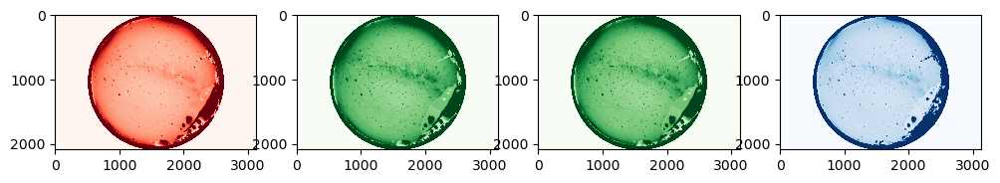

In [7]:
vmin , vmax = 0 , 900
fig,ax = plt.subplots(1,4,figsize=(12,6))
ax[0].imshow(R1,cmap='Reds',vmin=vmin,vmax=vmax)
ax[1].imshow(G2,cmap='Greens',vmin=vmin,vmax=vmax)
ax[2].imshow(G3,cmap='Greens',vmin=vmin,vmax=vmax)
ax[3].imshow(B4,cmap='Blues',vmin=vmin,vmax=vmax)

#### Read the coords table created by sextractor
<pre>
Not used in this version. 
The RGB standard stars are located using the WCS transformation 
and then the photometry is performed in these stars.
</pre>

In [8]:
# print(ipath + ifile.replace('.CR2','_coor.csv'))

#### Read the result of coordinate transformation
<pre>
The asdf file contents the WCS astrometry transformation.
The WCS transform from pixel X,Y to RA & DEC
</pre>

In [9]:
ofile = ipath+ifile.replace('.CR2','_wcs.asdf')  # the wcs obtained with the astrometry procedure
asdf_file = asdf.open(ofile)
print('Using ', ofile)
# WCS transform in RA & DEC
gwcs_radec = asdf_file.tree['wcs']

Using  ./IMG_9467_wcs.asdf


### Reading RGB standard stars
<pre>
    Read all the stars in the bright star RGB photometry catalogue
    and then select the stars above the horizont for this location and datetime.
</pre>

In [10]:
# get the standard RGB star catalog   (bright stars)
rgb_star_file = 'paper1_rgb_table_Ra-Dec.csv'
rgb_star = Table.read(rgb_star_file)
mask_var = rgb_star['Var.Name'] == '---'
tab_rgb = rgb_star[mask_var]         # Not using the variable stars
# The whole list of standard stars 
radec_rgb = SkyCoord(tab_rgb['RA'],tab_rgb['DEC'],unit=(u.deg, u.deg),frame='icrs')

#### Find Horizontal coordinates

In [11]:
azalt_rgb = radec_rgb.transform_to(azalt_frame)
tab_rgb['alt'] = azalt_rgb.alt.deg
tab_rgb['az']  = azalt_rgb.az.deg
# Also the airmass to perform photometry
tab_rgb['secz']  = azalt_rgb.secz.value

In [12]:
tab_rgb.info

<Table length=752>
      name        dtype 
---------------- -------
             #HR   int64
        Var.Name    str9
      standard_B float64
Error_standard_B float64
      standard_G float64
Error_standard_G float64
      standard_R float64
Error_standard_R float64
              RA float64
             DEC float64
             alt float64
              az float64
            secz float64

#### Selecting the stars used for the absolute photometry
<pre>
    For the Bouguer fit we select stars above 15 or 20 deg.
    altitude h = 20
    zenith angle     z = 90 - h = 70 
    airmass = sec (z) = 1/ cos(z) = 2.9 for h=20 
    A simple regression line provides zero point and extinction coefficient (slope) for each channel.
</pre>

In [14]:
## To avoid near horizon stars
t_rgb = tab_rgb[(tab_rgb['alt']> 20 )]      ## To avoid near horizon stars
t_rgb = tab_rgb[(tab_rgb['alt']> 15 )]      # h=15 deg in this example

#### X,Y positions of standard stars 
<pre> This is the transformation from RA & DEC to X.Y position on the frame
</pre>

In [15]:
x_rgb, y_rgb = gwcs_radec.backward_transform(t_rgb['RA'], t_rgb['DEC'])

In [16]:
# Positions stored into table
t_rgb['x'] = np.round(x_rgb,2)
t_rgb['y'] = np.round(y_rgb,2)

(1400.0, 800.0)

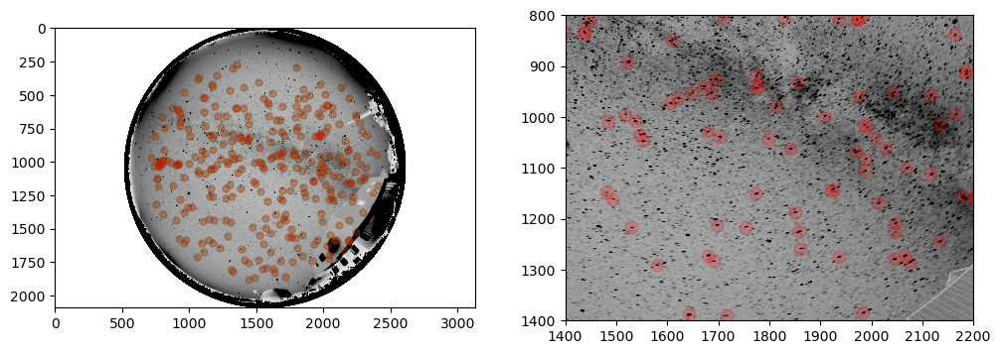

In [17]:
# Checking the astrometry
fig,ax = plt.subplots(1,2,figsize=(12,4))
ax[0].imshow(G2,cmap='gray_r',vmin=0,vmax=1200)
ax[0].scatter(t_rgb['x'],t_rgb['y'], c='green',s=25,marker='o',alpha=0.2)
ax[0].scatter(t_rgb['x'],t_rgb['y'], c='red',s=25,marker='o',alpha=0.2)

ax[1].imshow(G2,cmap='gray_r',vmin=0,vmax=900)
ax[1].scatter(t_rgb['x'],t_rgb['y'], c='red',s=85,marker='o',alpha=0.2)
plt.xlim(1400,2200)
plt.ylim(1400,800)

Text(100, 250, 'RGB standard stars')

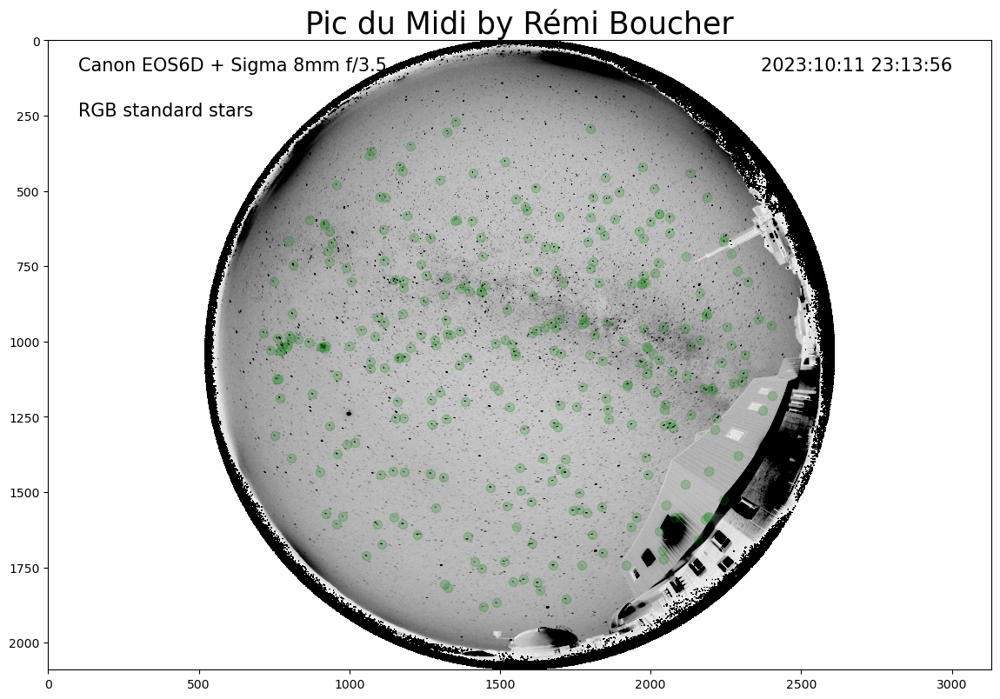

In [18]:
# Checking the astrometry
fig,ax = plt.subplots(1,1,figsize=(14,10))
ax.imshow(G2,cmap='gray_r',vmin=0,vmax=1500)
ax.scatter(t_rgb['x'],t_rgb['y'], c='green',s=55,marker='o',alpha=0.2)
plt.title('Pic du Midi by Rémi Boucher',fontsize=25)
plt.text(3000,100,'2023:10:11 23:13:56',ha='right',fontsize=15)
plt.text(100,100,'Canon EOS6D + Sigma 8mm f/3.5',fontsize=15)
plt.text(100,250,'RGB standard stars', fontsize=15)

#### BIAS
<pre> 
    We removed the BIAS when the vignetting correction was performed.
    >TODO: add the BIAS again after vignetting correction.
    In that case the BIAS should be removed before the photometry.
</pre>

In [21]:
# statistics of BIAS. 
# Could be obtained from exif 'RawMeasuredRGGB '
print('exif value for BIAS        :',vars[7])
print('dark statistics in a corner:' , B4[0:200,0:200].mean(),G2[0:200,0:200].mean(),R1[0:200,0:200].mean())
print(' zeroes because BIAS was substracted')

exif value for BIAS        : 2048 2048 2048 2048
dark statistics in a corner: 0.0 0.0 0.0
 zeroes because BIAS was substracted


In [22]:
#  In case BIAS should be removed
# Using 2048. as BIAS
#b_img = b_img - 2048.
#g_img = g_img - 2048.
#r_img = r_img - 2048.
#print(g_img[0:200,0:200].mean())

In [24]:
print('Exposure time from EXIF metadata ',vars[3], ' s')
texpo = float(vars[3])  # should be read from EXIF metadata

Exposure time from EXIF metadata  120.2  s


#### Using information from G2 and G3 to get more signal to noise value for G channel
<pre>
    >ToDo: Create a G channel image with the G2 and G3 images.
</pre>

### SEP photometry
<pre>
    Using sextractor to perform photometry.
    The background correction should be better 
    and the fluxes of the trailed star images (when exposure time is long)
    can be obtained using ellipse apertures.
</pre>

In [26]:
# After this error raises:
# ValueError: Input array with dtype '>f8' has non-native byte order. 
# Only native byte order arrays are supported. To change the byte order of the array 'data', 
# do 'data = data.byteswap().newbyteorder()'

BB = B4.byteswap().newbyteorder()
GG = G2.byteswap().newbyteorder()
RR = R1.byteswap().newbyteorder()

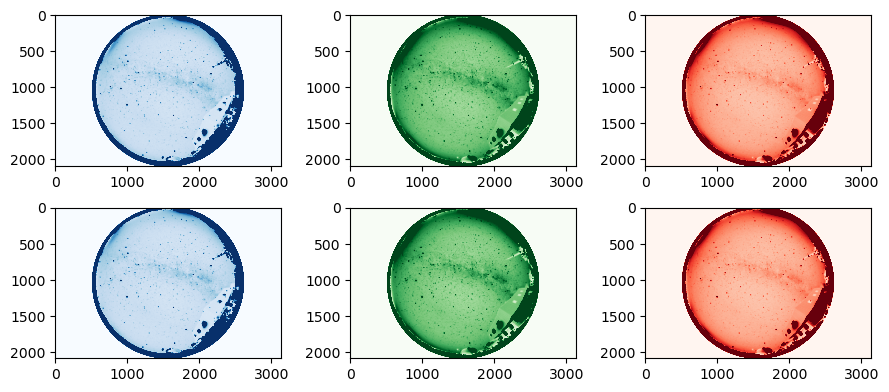

In [27]:
vmin , vmax = 0 , 900
fig,ax = plt.subplots(2,3,figsize=(9,4))
ax[0,0].imshow(B4,cmap='Blues',vmin=vmin,vmax=vmax)
ax[1,0].imshow(BB,cmap='Blues',vmin=vmin,vmax=vmax)
ax[0,1].imshow(G2,cmap='Greens',vmin=vmin,vmax=vmax)
ax[1,1].imshow(GG,cmap='Greens',vmin=vmin,vmax=vmax)
ax[0,2].imshow(R1,cmap='Reds',vmin=vmin,vmax=vmax)
ax[1,2].imshow(RR,cmap='Reds',vmin=vmin,vmax=vmax)
plt.tight_layout()

In [28]:
t_rgb.info

<Table length=302>
      name        dtype 
---------------- -------
             #HR   int64
        Var.Name    str9
      standard_B float64
Error_standard_B float64
      standard_G float64
Error_standard_G float64
      standard_R float64
Error_standard_R float64
              RA float64
             DEC float64
             alt float64
              az float64
            secz float64
               x float64
               y float64

unmasked 366.7 49.2
SEP extract   flux  & cflux.  simple background
0 1.2765133047041188 2.2778912908816666 10607.81640625
1 5.978470904872639 7.825122281341295 7338.86474609375
2 37.74001695963298 31.64562824512286 18351.7109375
3 58.185631897819626 32.03237290392822 91448.953125
4 35.22542440126185 35.74374775849786 45825.71484375
5 35.52920590874753 42.9608215763313 14667.568359375
6 1.8591102547155458 45.899510736240785 8239.205078125
7 64.3939869094557 59.368643963409575 11805.0029296875
masked 366.4 49.1
masked substracted 62.2 556.6
SEP extract   flux  & cflux.  masked background
0 1.276353302109869 2.277790233424318 10599.57421875 8418.8154296875 11 11
1 6.133562085480925 7.838494862472095 7373.3955078125 5119.060546875 9 9
2 37.740072218740245 31.64565619671496 18348.3359375 15634.197265625 15 15
3 58.1856466361894 32.03238278993303 91451.828125 90009.875 27 27
4 35.22543982633076 35.74373645231254 45820.27734375 43915.87109375 23 23
5 35.529262002593754 42.96084252844792 1466

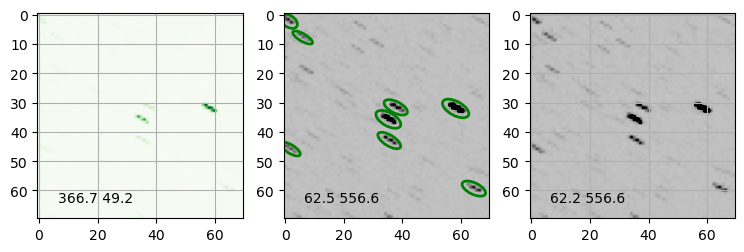

In [31]:
i = 48
size = 35
fig,ax = plt.subplots(1,3,figsize=(9,4))
yy = int(t_rgb['x'][i])
xx = int(t_rgb['y'][i])
fg = np.ascontiguousarray(GG[xx-size:xx+size,yy-size:yy+size])

im = ax[0].imshow(fg,cmap='Greens')
bkg = sep.Background(fg)
bck = round(bkg.globalback,1)
std = round(bkg.globalrms,1)
plt.text(0.1,0.1,str(bck)+' '+str(std),ha='left',va='center', transform=ax[0].transAxes)
ax[0].grid()
#plt.colorbar(im)
print('unmasked',bck,std)

#bkg_image = np.array(bkg)
bkg_image = bkg.back()
fg_sub = fg - bkg_image
m,s = round(np.mean(fg_sub),1), round(np.std(fg_sub),1)
im = ax[1].imshow(fg_sub,cmap='Grays',vmin=m-3*s,vmax=m+5*s)
#plt.colorbar(im)
plt.text(0.1,0.1,str(m)+' '+str(s),ha='left',va='center', transform=ax[1].transAxes)

objects = sep.extract(fg_sub,8,err=bkg.globalrms)
print('SEP extract   flux  & cflux.  simple background')
for i in range(len(objects)):
    print(i,objects['x'][i],objects['y'][i],objects['flux'][i])
for i in range(len(objects)):
    e = Ellipse(xy=(objects['x'][i],objects['y'][i]),width=6*objects['a'][i],height=6*objects['b'][i],angle= objects['theta'][i] *180 /np.pi)
    e.set_facecolor('none')
    e.set_edgecolor('green')
    e.set_alpha(1)
    e.set_linewidth(2)
    ax[1].add_artist(e)

mask = np.zeros(fg.shape,dtype=bool)
sep.mask_ellipse(mask,objects['x'],objects['y'],objects['a'],objects['b'],objects['theta'],r=6.)
bkg = sep.Background(fg,mask=mask) #,bw=8,bh=8,fw=3,fh=3)
bck = round(bkg.globalback,1)
std = round(bkg.globalrms,1)
print('masked',bck,std)

#bkg_image = np.array(bkg)
bkg_image = bkg.back()
fg_sub = fg - bkg_image
m,s = round(np.mean(fg_sub),1), round(np.std(fg_sub),1)
print('masked substracted',m,s)
im = ax[2].imshow(fg_sub,cmap='Grays',vmin=m-3*s,vmax=m+5*s)
plt.text(0.1,0.1,str(m)+' '+str(s),ha='left',va='center', transform=ax[2].transAxes)
ax[2].grid()

print('SEP extract   flux  & cflux.  masked background')
objects = sep.extract(fg_sub,8,err=bkg.globalrms)

for i in range(len(objects)):
    print(i,objects['x'][i],objects['y'][i],objects['flux'][i],objects['cflux'][i],objects['npix'][i],objects['npix'][i])

# r=6
cflux,cfluxerr,flag = sep.sum_circle(fg_sub,objects['x'],objects['y'],3,err=bkg.globalrms,gain=1.0)
eflux,efluxerr,flag = sep.sum_ellipse(fg_sub,objects['x'],objects['y'],objects['a'],objects['b'],objects['theta'],r=6,err=bkg.globalrms,gain=1.0)
print('SEP circular radius 3')
for i in range(len(objects)):
    print("object {:d}: flux = {:f} +/- {:f}".format(i, cflux[i], cfluxerr[i]))
print('SEP ellipse r=6')
for i in range(len(objects)):
    print("object {:d}: flux = {:f} +/- {:f}".format(i, eflux[i], efluxerr[i]))

# r=4
cflux,cfluxerr,flag = sep.sum_circle(fg_sub,objects['x'],objects['y'],3,err=bkg.globalrms,gain=1.0)
eflux,efluxerr,flag = sep.sum_ellipse(fg_sub,objects['x'],objects['y'],objects['a'],objects['b'],objects['theta'],r=4,err=bkg.globalrms,gain=1.0)
print('SEP circular radius 3')
for i in range(len(objects)):
    print("object {:d}: flux = {:f} +/- {:f}".format(i, cflux[i], cfluxerr[i]))
print('SEP ellipse r=4')
for i in range(len(objects)):
    print("object {:d}: flux = {:f} +/- {:f}".format(i, eflux[i], efluxerr[i]))

SEP ellipse r= 0.5
object 0: flux = 1087.625454 +/- 49.352053 1.276353302109869 2.277790233424318
SEP ellipse r= 1.0
object 0: flux = 4169.621636 +/- 98.274647 1.276353302109869 2.277790233424318
SEP ellipse r= 1.5
object 0: flux = 7230.125175 +/- 139.493399 1.276353302109869 2.277790233424318
SEP ellipse r= 2.0
object 0: flux = 9709.954332 +/- 176.310460 1.276353302109869 2.277790233424318
SEP ellipse r= 2.5
object 0: flux = 10697.958487 +/- 204.446172 1.276353302109869 2.277790233424318
SEP ellipse r= 3.0
object 0: flux = 10855.550069 +/- 229.441803 1.276353302109869 2.277790233424318
SEP ellipse r= 3.5
object 0: flux = 10963.976251 +/- 254.912240 1.276353302109869 2.277790233424318
SEP ellipse r= 4.0
object 0: flux = 11005.189126 +/- 276.897151 1.276353302109869 2.277790233424318
SEP ellipse r= 4.5
object 0: flux = 11101.415217 +/- 298.484215 1.276353302109869 2.277790233424318
SEP ellipse r= 5.0
object 0: flux = 11290.728813 +/- 320.264837 1.276353302109869 2.277790233424318
SEP el

Text(0, 0.5, 'sep flux')

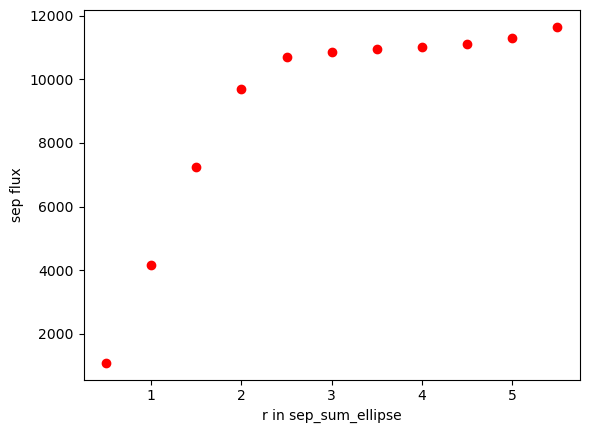

In [32]:
for i in range(1,12):
    r = i*0.5
    eflux,efluxerr,flag = sep.sum_ellipse(fg_sub,objects['x'],objects['y'],objects['a'],objects['b'],objects['theta'],r=r,err=bkg.globalrms,gain=1.0)
    print('SEP ellipse r=',r)
    for i in range(0,1): #len(objects)):
        print("object {:d}: flux = {:f} +/- {:f}".format(i, eflux[i], efluxerr[i]),objects['x'][i],objects['y'][i])
    plt.plot(r,eflux[0],'ro')
plt.xlabel('r in sep_sum_ellipse')
plt.ylabel('sep flux')

### All RGB stars photometry using SEP

In [35]:
# fluxes with SEP in another column
t_rgb['Fgs'] = 0 
t_rgb['Frs'] =  0
t_rgb['Fbs'] =  0

*RGB star 0 HR 27  object 7: cflux = 4770.7 +/- 345.4 position: 36.6 32.1
*RGB star 0 HR 27  object 7: eflux = 22970.5 +/- 528.2 position: 36.6 32.1
*RGB star 0 HR 27  object 9: cflux = 25414.2 +/- 559.6 position: 34.2 35.8
*RGB star 0 HR 27  object 9: eflux = 26671.4 +/- 530.4 position: 34.2 35.8
*RGB star 1 HR 33  object 4: cflux = 14332.3 +/- 488.7 position: 35.3 35.4
*RGB star 1 HR 33  object 4: eflux = 14339.7 +/- 479.9 position: 35.3 35.4
*RGB star 2 HR 72  object 2: cflux = 3865.6 +/- 317.1 position: 34.7 35.2
*RGB star 2 HR 72  object 2: eflux = 3846.4 +/- 438.7 position: 34.7 35.2
*RGB star 3 HR 159  object 5: cflux = 8207.5 +/- 436.2 position: 35.2 36.0
*RGB star 3 HR 159  object 5: eflux = 9155.8 +/- 475.3 position: 35.2 36.0
*RGB star 4 HR 163  object 6: cflux = 31925.2 +/- 429.1 position: 35.1 36.5
*RGB star 4 HR 163  object 6: eflux = 31011.0 +/- 446.7 position: 35.1 36.5
*RGB star 5 HR 173  object 6: cflux = 3223.9 +/- 274.0 position: 35.5 36.5
*RGB star 5 HR 173  object

/var/folders/8d/2bcbltss6ll32_vkykfqr14c0000gp/T/ipykernel_24111/3199913864.py:7: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig,ax = plt.subplots(1,3,figsize=(12,6))


*RGB star 27 HR 442  object 16: cflux = 21588.3 +/- 469.4 position: 35.5 35.0
*RGB star 27 HR 442  object 16: eflux = 22323.7 +/- 611.9 position: 35.5 35.0
*RGB star 28 HR 448  object 5: cflux = 6584.7 +/- 389.4 position: 35.2 36.0
*RGB star 28 HR 448  object 5: eflux = 6468.4 +/- 466.6 position: 35.2 36.0
*RGB star 29 HR 458  object 11: cflux = 40013.9 +/- 457.0 position: 34.8 36.2
*RGB star 29 HR 458  object 11: eflux = 43562.6 +/- 516.5 position: 34.8 36.2
*RGB star 30 HR 461  object 15: cflux = 10384.7 +/- 464.8 position: 35.4 35.2
*RGB star 30 HR 461  object 15: eflux = 11869.7 +/- 640.4 position: 35.4 35.2
*RGB star 31 HR 464  object 13: cflux = 70150.3 +/- 633.9 position: 34.8 36.1
*RGB star 31 HR 464  object 13: eflux = 69510.0 +/- 586.3 position: 34.8 36.1
*RGB star 32 HR 483  object 9: cflux = 18496.0 +/- 379.3 position: 35.0 35.6
*RGB star 32 HR 483  object 9: eflux = 18746.7 +/- 447.1 position: 35.0 35.6
*RGB star 33 HR 489  object 2: cflux = 24401.5 +/- 463.5 position: 35.

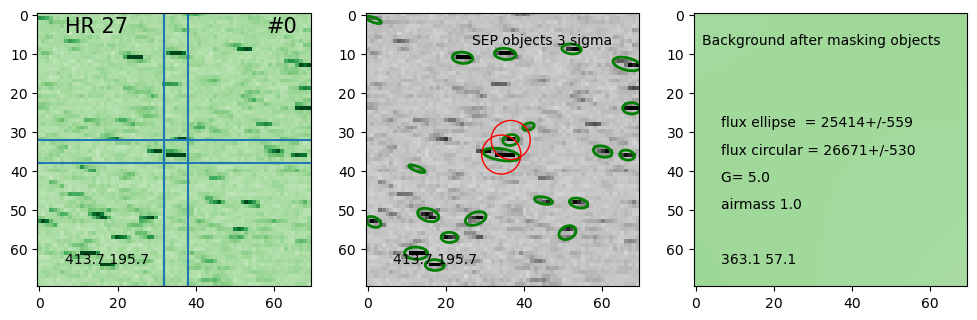

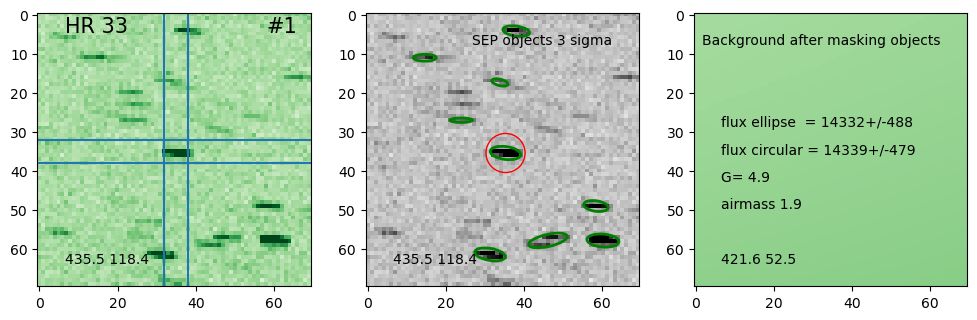

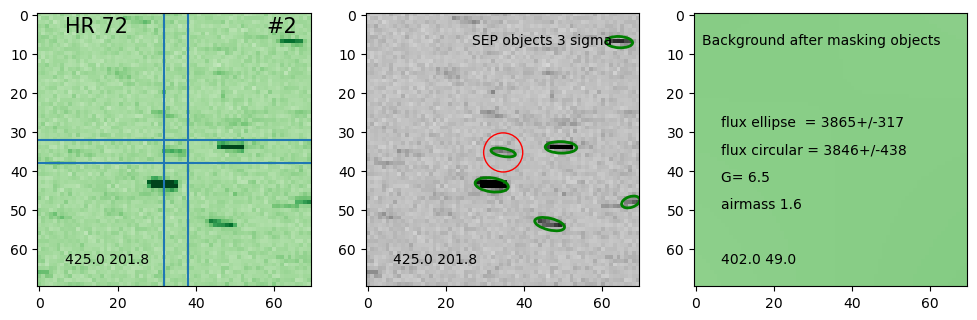

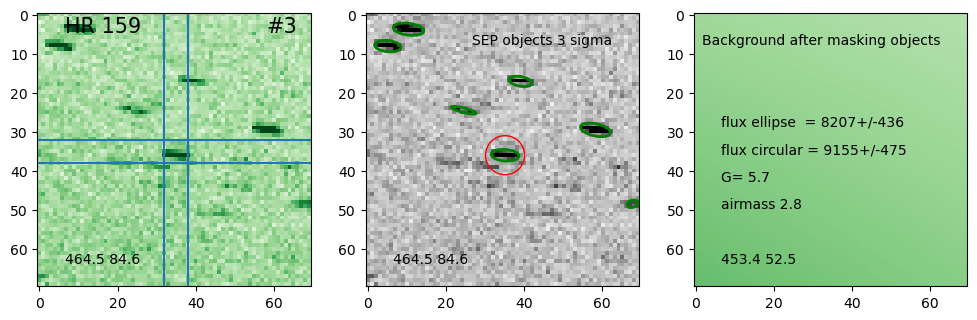

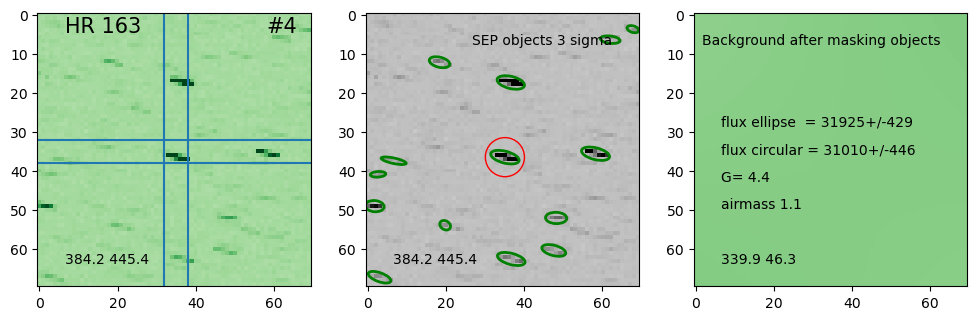

...

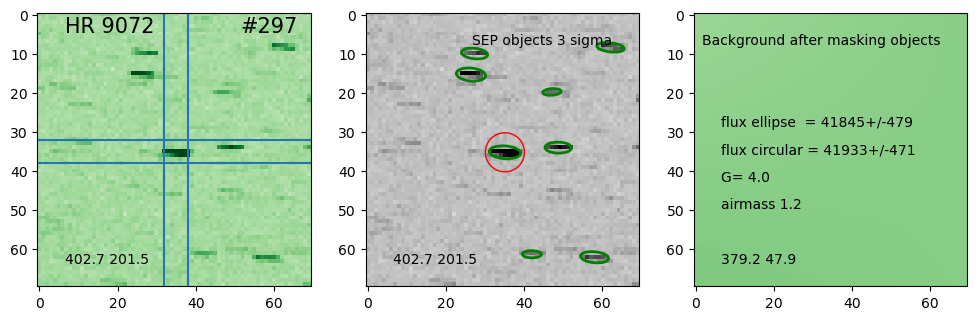

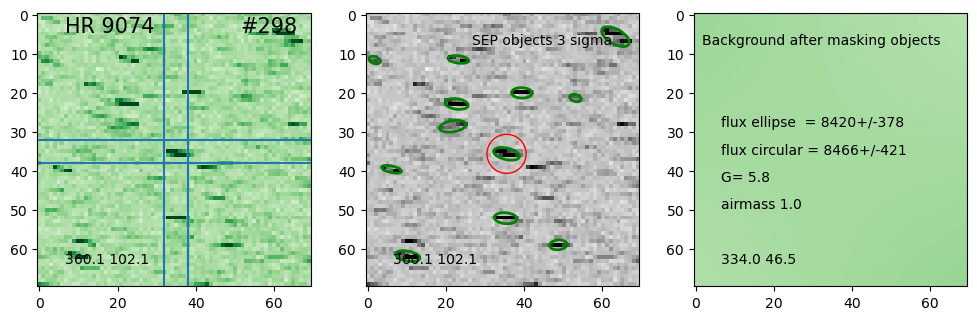

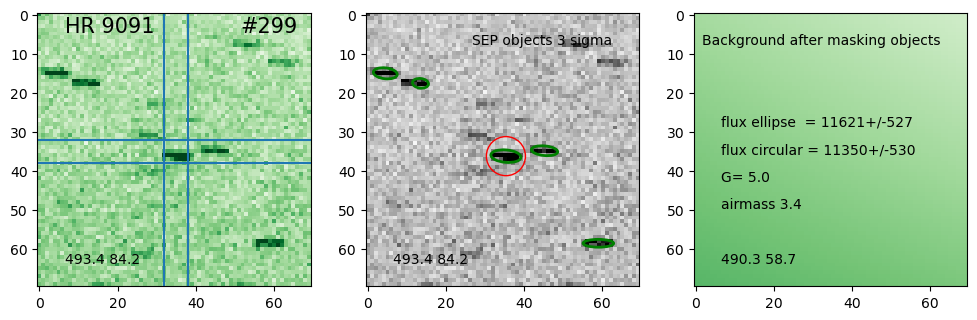

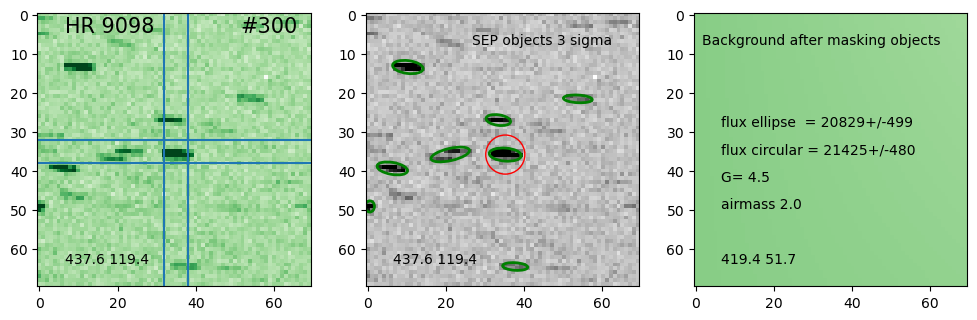

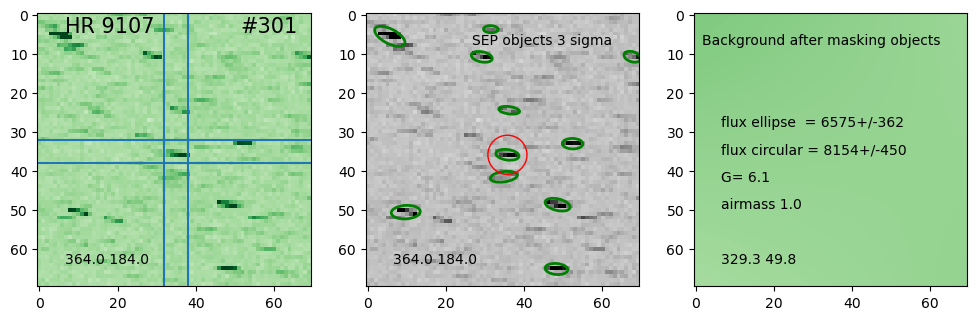

In [37]:
size = 35       # frame size
dx , dy = 3 , 3 # pointing size
radius = 5      # photometry circular aperture
r = 4           # photometry SEB r parameter 
for i in range(0,len(t_rgb)):
    #print('RGB star '+str(i)+'. HR '+str(t_rgb['#HR'][i]),t_rgb['x'][i],t_rgb['x'][i])
    fig,ax = plt.subplots(1,3,figsize=(12,6))
    yy = int(t_rgb['x'][i])
    xx = int(t_rgb['y'][i])
    fg = np.ascontiguousarray(GG[xx-size:xx+size,yy-size:yy+size])
    fr = np.ascontiguousarray(RR[xx-size:xx+size,yy-size:yy+size])
    fb = np.ascontiguousarray(BB[xx-size:xx+size,yy-size:yy+size])
    m,s = round(np.mean(fg),1), round(np.std(fg),1)
    im = ax[0].imshow(fg,cmap='Greens',vmin=m-3*s,vmax=m+5*s)
    plt.text(0.1,0.1,str(m)+' '+str(s),ha='left',va='center', transform=ax[0].transAxes)
    plt.text(0.1,0.95,'HR '+str(t_rgb['#HR'][i]),ha='left',va='center', transform=ax[0].transAxes,fontsize=15)
    plt.text(0.95,0.95,'#'+str(i),ha='right',va='center', transform=ax[0].transAxes,fontsize=15)
    
    ax[0].axvline(size-dy)
    ax[0].axhline(size-dx)
    ax[0].axvline(size+dy)
    ax[0].axhline(size+dx)
    
    bkg = sep.Background(fg)
    bck = round(bkg.globalback,1)
    std = round(bkg.globalrms,1)
    #bkg_image = np.array(bkg)
    bkg_image = bkg.back()
    fg_sub = fg - bkg_image
    msub,ssub = round(np.mean(fg_sub),1), round(np.std(fg_sub),1)
    objects = sep.extract(fg_sub,3,err=bkg.globalrms)    # 10xstd too high
    #print('objects',len(objects))
    im = ax[1].imshow(fg_sub,cmap='Grays',vmin=msub-3*ssub,vmax=msub+5*ssub)
    for j in range(len(objects)):
        e = Ellipse(xy=(objects['x'][j],objects['y'][j]),width=r*objects['a'][j],height=r*objects['b'][j],angle= objects['theta'][j] *180 /np.pi)
        e.set_facecolor('none')
        e.set_edgecolor('green')
        e.set_alpha(1)
        e.set_linewidth(2)
        ax[1].add_artist(e)
    plt.text(0.1,0.1,str(m)+' '+str(s),ha='left',va='center', transform=ax[1].transAxes)
    plt.text(0.9,0.9,'SEP objects 3 sigma',ha='right',va='center', transform=ax[1].transAxes)
    
    flux,fluxerr,flag = sep.sum_circle(fg_sub,objects['x'],objects['y'],radius,err=bkg.globalrms,gain=1.0)
    mask = np.zeros(fg.shape,dtype=bool)
    sep.mask_ellipse(mask,objects['x'],objects['y'],objects['a'],objects['b'],objects['theta'],r=r)
    
    
    bkg_g = sep.Background(fg,mask=mask) #,bw=8,bh=8,fw=3,fh=3)
    bck_g = round(bkg.globalback,1)
    std_g = round(bkg.globalrms,1)
    bkg_r = sep.Background(fr,mask=mask)
    bck_r = round(bkg.globalback,1)
    std_r = round(bkg.globalrms,1)
    bkg_b = sep.Background(fb,mask=mask)
    bck_b = round(bkg.globalback,1)
    std_b = round(bkg.globalrms,1)
    bkg_image_r = np.array(bkg_r)
    bkg_image_g = np.array(bkg_g)
    bkg_image_b = np.array(bkg_b)
    
    fr_sub = fr - bkg_image_r
    fg_sub = fg - bkg_image_g
    fb_sub = fb - bkg_image_b
    
    im = ax[2].imshow(bkg_image_g,cmap='Greens',vmin=m-1*s,vmax=m+1*s)
    plt.text(0.1,0.1,str(bck)+' '+str(std),ha='left',va='center', transform=ax[2].transAxes)
    plt.text(0.9,0.9,'Background after masking objects',ha='right',va='center', transform=ax[2].transAxes)

    # Using a circular aperture (not used here, just to compare)
    cfluxr,cfluxterr,flagg = sep.sum_circle(fr_sub,objects['x'],objects['y'],radius,err=std_r,gain=1) #err=bkg.globalrms,gain=1.0)
    cfluxg,cfluxgerr,flagg = sep.sum_circle(fg_sub,objects['x'],objects['y'],radius,err=std_g,gain=1.0)
    cfluxb,cfluxberr,flagg = sep.sum_circle(fb_sub,objects['x'],objects['y'],radius,err=std_b,gain=1.0)
    # **** Using an ellipse as aperture ****
    #sep.sum_ellipse(data, x, y, a, b, theta, r, err=None, var=None, mask=None, maskthresh=0.0, seg_id=None, segmap=None, bkgann=None, gain=None, subpix=5)
    efluxr,efluxrerr,flag = sep.sum_ellipse(fr_sub,objects['x'],objects['y'],objects['a'],objects['b'],objects['theta'],r=r,err=std_r,gain=1.0)
    efluxg,efluxgerr,flag = sep.sum_ellipse(fg_sub,objects['x'],objects['y'],objects['a'],objects['b'],objects['theta'],r=r,err=std_g,gain=1.0)
    efluxb,efluxberr,flag = sep.sum_ellipse(fb_sub,objects['x'],objects['y'],objects['a'],objects['b'],objects['theta'],r=r,err=std_b,gain=1.0)
    
    for j in range(len(objects)):
        if objects['x'][j] > size - dx and objects['x'][j]< size + dx:
            if objects['y'][j] > size - dy and objects['y'][j]< size + dy:
                e = Circle(xy=(objects['x'][j],objects['y'][j]),radius=radius)
                e.set_facecolor('none')
                e.set_edgecolor('red')
                e.set_alpha(1)
                e.set_linewidth(1)
                ax[1].add_artist(e)
                label1= 'flux ellipse  = '+str(int(efluxg[j]))+'+/-'+str(int(efluxgerr[j]))
                label2= 'flux circular = '+str(int(cfluxg[j]))+'+/-'+str(int(cfluxgerr[j]))
                t_rgb['Frs'][i] = int(efluxr[j]) / texpo
                t_rgb['Fgs'][i] = int(efluxg[j]) / texpo
                t_rgb['Fbs'][i] = int(efluxb[j]) / texpo
                #print(i,j,int(efluxr[j]), int(cfluxr[j]))
                print('*RGB star '+str(i)+' HR '+str(t_rgb['#HR'][i])+"  object {:d}: cflux = {:.1f} +/- {:.1f} position: {:.1f} {:.1f}".format(j, efluxg[j], efluxgerr[j],objects['x'][j],objects['y'][j]))
                print('*RGB star '+str(i)+' HR '+str(t_rgb['#HR'][i])+"  object {:d}: eflux = {:.1f} +/- {:.1f} position: {:.1f} {:.1f}".format(j, cfluxg[j], cfluxgerr[j],objects['x'][j],objects['y'][j]))
        #print(j,
    #print(j,objects['x'][j],objects['y'][j],objects['flux'][j],objects['cflux'][j])    
    
    plt.text(0.1,0.6,label1,ha='left',va='center', transform=ax[2].transAxes)
    plt.text(0.1,0.5,label2,ha='left',va='center', transform=ax[2].transAxes)
    plt.text(0.1,0.4,'G= '+str(round(t_rgb['standard_G'][i],1)),ha='left',va='center', transform=ax[2].transAxes)
    plt.text(0.1,0.3,'airmass '+str(round(t_rgb['secz'][i],1)),ha='left',va='center', transform=ax[2].transAxes)

 

In [38]:
t_rgb.info()

<Table length=302>
      name        dtype 
---------------- -------
             #HR   int64
        Var.Name    str9
      standard_B float64
Error_standard_B float64
      standard_G float64
Error_standard_G float64
      standard_R float64
Error_standard_R float64
              RA float64
             DEC float64
             alt float64
              az float64
            secz float64
               x float64
               y float64
             Fgs   int64
             Frs   int64
             Fbs   int64


In [39]:
from astropy.io import ascii
ascii.write(t_rgb, 'table_RGB-std_fluxes.csv', overwrite=True)

/var/folders/8d/2bcbltss6ll32_vkykfqr14c0000gp/T/ipykernel_24111/1670333831.py:2: RuntimeWarning: divide by zero encountered in log10
  im = plt.scatter(t_rgb['secz'],t_rgb['standard_G']+2.5*np.log10(t_rgb['Fgs']),c=t_rgb['standard_G'],s=20)


Text(0.5, 1.0, 'Bouguer SEP photometry ellipse ')

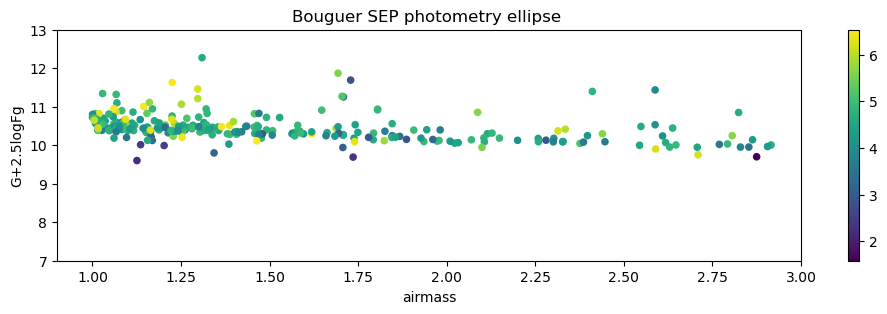

In [41]:
fig,ax = plt.subplots(1,1,figsize=(12,3))
im = plt.scatter(t_rgb['secz'],t_rgb['standard_G']+2.5*np.log10(t_rgb['Fgs']),c=t_rgb['standard_G'],s=20)
plt.xlim(0.9,3)
plt.ylim(7,13)
plt.xlabel('airmass')
plt.ylabel('G+2.5logFg')
plt.colorbar(im)
plt.title('Bouguer SEP photometry ellipse ')

### Removing negative flux points

In [44]:
print(len(t_rgb))
mask_R = t_rgb['Frs']>0
mask_G = t_rgb['Fgs']>0
mask_B = t_rgb['Fbs']>0
mask = mask_R & mask_G & mask_B
t_rgb = t_rgb[mask]
print(len(t_rgb))

302
278


### Bouguer fits

In [45]:
fsize = 15

### Bouguer fits + Color terms

#### Fitting Bouguer with color terms

## Using the Bouguer fit written by Nicolas Cardiel

<pre>
    Iterative fitting removing outliers 
</pre>

In [60]:
def phot_fit_color_term(x , y , z , label, fsize=12, tsigma=3.0, niterations_max=100):
    # x    sec z (airmass)
    # y    m + 2.5 log10(flux)
    # z    color index
    # tsigma: times sigma to remove points
    # niterations_max: maximum number of iterations when rejecting outliers
    # output  zero point, extinction coefficient and color term
   
    # A Simple fit and show residuals
    print("Fitting Bouguer extinction law")
    # Fitting the Bouguer law
    model = lmfit.models.ExpressionModel("m0 - k*x")    # m0 is the zero point, k is the extinction (positive)
    params = model.make_params(m0=17.0, k=0.2)          # first guesses
    airmass = np.array(x);  #list(x)
    mlogf   = np.array(y);  #list(y)   # m + 2.5 log10(flux)
    z = np.array(z)

    # Iterative fit to remove points beyond tsgima times the robust rms
    npoints = len(airmass)
    reject = np.zeros(npoints, dtype=bool)  # auxiliary boolean array to flag outliers
    loop_to_reject_points = True
    niterations = 0
    while loop_to_reject_points:
        print(f'\nIteration #{niterations}')
        print(f'Number of points in fit..: {npoints - np.sum(reject)}')
        print(f'Number of points rejected: {np.sum(reject)}')
        # repeat fit avoiding outliers
        bouguer = model.fit(mlogf[~reject], params, x=airmass[~reject])
        #print(bouguer.fit_report())
        m0 = round(bouguer.params['m0'].value,2)
        k = round(bouguer.params['k'].value,2)
        print(f'Fit result: m0={m0}, k={k}')
        yfit = bouguer.eval(params=bouguer.params, x=np.array(x))
        fit_difference =  np.abs(np.subtract(y, yfit))
        # compute robust rms of residuals
        q25, q75 = np.percentile(fit_difference, [25, 75])
        robust_rms = 0.7413 * (q75 - q25)
        # reject points
        reject_after_fit = (fit_difference > tsigma * robust_rms)
        # check if there are new rejected points
        if np.all(reject == reject_after_fit):
            loop_to_reject_points = False
        else:
            # try again
            reject = reject_after_fit
        # avoid infinite loop
        if niterations > niterations_max:
            loop_to_reject_points = False
        niterations += 1
    print('')
    
    # Graph the results
    figura=plt.figure(figsize=(12,12))
    ax1 = plt.subplot(411)
    plot_1 = ax1.scatter(x, y, c=z, s=40, edgecolor='black', cmap='jet')
    ax1.set_xlim(0.8,5) #2.8)
    ax1.axvline(1.0, ls='--', lw=1)
    ax1.axvline(3.0, ls='--', lw=1)
    xfit = np.arange(0,4.9,0.2)
    yfit = bouguer.eval(params=bouguer.params, x=xfit)
    ax1.plot(xfit,yfit,c='m',lw=2,alpha=0.75)
    divider = make_axes_locatable(ax1)
    cax = divider.append_axes("right", size="5%", pad=0.05)
    figura.colorbar(plot_1, cax=cax, label='B-G')
    ax1.set_ylabel('m + 2.5 log(flux) ',fontsize=fsize)

    ax1.text(0.95,0.85,label,ha='right',transform=ax1.transAxes,color='black',fontsize=15)
    ax1.text(0.65,0.85,'m= '+str(m0),ha='left',transform=ax1.transAxes,color='black')
    ax1.text(0.75,0.85,'K= '+str(k),ha='left',transform=ax1.transAxes,color='black')

    # ********** second plot ****************
    # differences O-C after fit
    ax2 = plt.subplot(412)
    yfit = bouguer.eval(params=bouguer.params, x=np.array(x))
    fit_difference    =  np.subtract( y , yfit)
   
    plot_2 = ax2.scatter(x,fit_difference, c=z, s=40,
          edgecolor='black', cmap='jet')
    ax2.set_xlim(0.8,5) #2.8)
    ax2.axvline(1.0, ls='--', lw=1)
    ax2.axhline(0.0, ls='--', lw=2,color='black')

    x2 = airmass[~reject]
    y2 = mlogf[~reject]
    z2 = z[~reject]
    ax2.plot(airmass[reject], fit_difference[reject], 'kx', ms=10)

    divider = make_axes_locatable(ax2)
    cax = divider.append_axes("right", size="5%", pad=0.05)
    figura.colorbar(plot_2, cax=cax, label='B-G')

    #ax2.set_xlabel('airmass',fontsize=fsize)
    ax2.set_ylabel('O-C',fontsize=fsize)

    # new fit without outliers
    ax3 = plt.subplot(413)
    plot_3 = ax3.scatter(x2, y2 , c=z2, s=40, edgecolor='black', cmap='jet')  
    divider = make_axes_locatable(ax3)
    cax = divider.append_axes("right", size="5%", pad=0.05)
    figura.colorbar(plot_3, cax=cax, label='B-G')
    ax3.set_ylabel('m + 2.5 log(flux) ',fontsize=fsize)

    bouguer = model.fit(y2, params, x=x2)
    #print(bouguer.fit_report())
    m0 = round(bouguer.params['m0'].value,2)
    k = round(bouguer.params['k'].value,2)
    m0_std = round(bouguer.params['m0'].stderr,2)
    k_std  = round(bouguer.params['k'].stderr,2)
    ax3.set_xlim(0.8,5) #2.8)
    ax3.axvline(1.0, ls='--', lw=1)
    ax3.axvline(3.0, ls='--', lw=1)
    xfit = np.arange(0,4.9,0.2)
    yfit = bouguer.eval(params=bouguer.params, x=xfit)
    ax3.plot(xfit,yfit,c='k',alpha=0.75)
    divider = make_axes_locatable(ax3)
    cax = divider.append_axes("right", size="5%", pad=0.05)
    figura.colorbar(plot_3, cax=cax, label='B-G')
    ax3.set_ylabel('m + 2.5 log(flux) ',fontsize=fsize)

    ax3.text(0.95,0.85,label,ha='right',transform=ax3.transAxes,color='black',fontsize=15)
    ax3.text(0.65,0.85,'m= '+str(m0),ha='left',transform=ax3.transAxes,color='black')
    ax3.text(0.75,0.85,'K= '+str(k),ha='left',transform=ax3.transAxes,color='black')

    # Color term
    yfit = bouguer.eval(params=bouguer.params, x=np.array(x2))
    fit_difference    =  np.subtract( yfit , y2)
    #coef = np.polyfit(zz,fit_difference,1)
    #poly1d_fn = np.poly1d(coef)
    #print(coef)
    #c = round(coef[0],2)
    #yyb = np.add(yy,poly1d_fn(zz))
    model2 = lmfit.models.ExpressionModel("a+c*x")    # C is color term
    params = model2.make_params(a=0,c=0.2)      # first guesses
    color = model2.fit(fit_difference,params, x=z2)
    #print(color.fit_report())
    yyb = np.add(y2,color.eval(params=color.params, x=np.array(z2)))
    c = round(color.params['c'].value,3)
    c_std = round(color.params['c'].stderr,3)
   
    ax4 = plt.subplot(414)
    plot_4 = ax4.scatter(x2, yyb , c=z2, s=40, edgecolor='black', cmap='jet')
    ax4.plot(x2, y2 , 'ko',ms=1)
    ax4.axvline(1.0, ls='--', lw=1)
    ax4.axvline(3.0, ls='--', lw=1)
    xfit = np.arange(0,4.9,0.2)
    yfit = bouguer.eval(params=bouguer.params, x=xfit)
    ax4.plot(xfit,yfit,c='k',alpha=0.75)
    divider = make_axes_locatable(ax4)
    cax = divider.append_axes("right", size="5%", pad=0.05)
    figura.colorbar(plot_4, cax=cax, label='B-G')
    ax4.set_xlabel('airmass',fontsize=fsize)
    ax4.set_ylabel('m + 2.5 log(flux) ',fontsize=fsize)
    ax4.set_xlim(0.8,5) #2.8)
    ax4.text(0.80,0.85,label,ha='left',transform=ax4.transAxes,color='black',fontsize=18)
    ax4.text(0.80,0.70,'m= '+str(m0)+'+/-'+str(m0_std),ha='left',transform=ax4.transAxes,color='black',fontsize=12)
    ax4.text(0.80,0.60,'K= '+str(k)+'+/-'+str(k_std),ha='left',transform=ax4.transAxes,color='black',fontsize=12)
    ax4.text(0.80,0.50,'c= '+str(c)+'+/-'+str(c_std),ha='left',transform=ax4.transAxes,color='black',fontsize=12)
   
    return bouguer,color

Fitting Bouguer extinction law

Iteration #0
Number of points in fit..: 278
Number of points rejected: 0
Fit result: m0=10.87, k=0.28

Iteration #1
Number of points in fit..: 236
Number of points rejected: 42
Fit result: m0=10.83, k=0.29

Iteration #2
Number of points in fit..: 233
Number of points rejected: 45
Fit result: m0=10.81, k=0.29

Iteration #3
Number of points in fit..: 238
Number of points rejected: 40
Fit result: m0=10.8, k=0.28

Parameters([('m0', <Parameter 'm0', value=10.80309458927786 +/- 0.0232, bounds=[-inf:inf]>), ('k', <Parameter 'k', value=0.2836727038426303 +/- 0.0128, bounds=[-inf:inf]>)])
Parameters([('a', <Parameter 'a', value=-0.001968945785879566 +/- 0.0107, bounds=[-inf:inf]>), ('c', <Parameter 'c', value=0.009754966839770313 +/- 0.0313, bounds=[-inf:inf]>)])


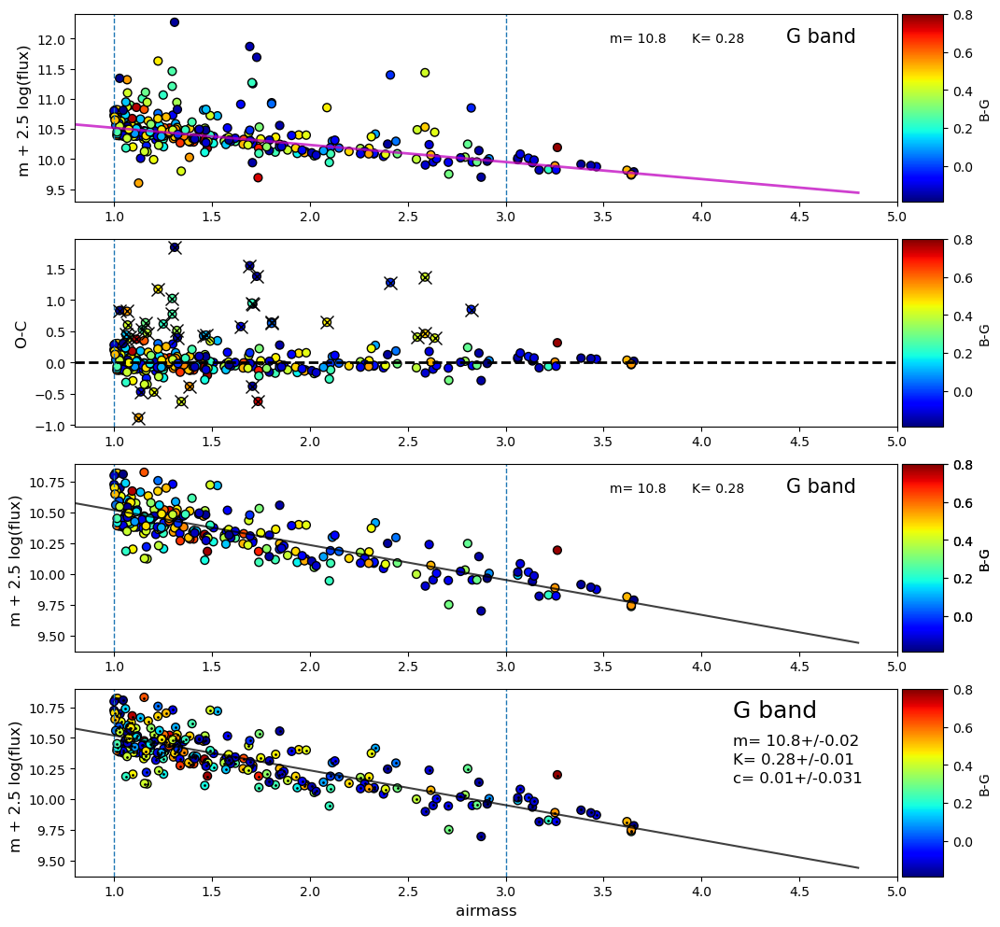

In [61]:
# Testing color term Bouger fit
x = t_rgb['secz']                                   # airmass
y = t_rgb['standard_G'] + 2.5 * np.log10(t_rgb['Fgs'])    # m + 2.5 log(flux)
z = t_rgb['standard_B'] - t_rgb['standard_G']   # B-G color index
#z = t_rgb['standard_B'] - t_rgb['standard_R']   # B-R color index

xx , yy ,zz = [],[],[]
for i in range(len(x)):
    if  y[i] > 0:
#    if np.isnan(y[i]) == False:
        xx.append(x[i])
        yy.append(y[i])
        zz.append(z[i])
        
bouguer_g, color_g = phot_fit_color_term(xx,yy,zz,label='G band')
print(bouguer_g.params)
print(color_g.params)
plt.savefig('fig_G_SEP.png')

Fitting Bouguer extinction law

Iteration #0
Number of points in fit..: 278
Number of points rejected: 0
Fit result: m0=10.74, k=0.36

Iteration #1
Number of points in fit..: 234
Number of points rejected: 44
Fit result: m0=10.63, k=0.34

Iteration #2
Number of points in fit..: 235
Number of points rejected: 43
Fit result: m0=10.62, k=0.35

Parameters([('m0', <Parameter 'm0', value=10.617377050038991 +/- 0.0207, bounds=[-inf:inf]>), ('k', <Parameter 'k', value=0.3456665420033075 +/- 0.0115, bounds=[-inf:inf]>)])
Parameters([('a', <Parameter 'a', value=0.025064086964703223 +/- 0.00907, bounds=[-inf:inf]>), ('c', <Parameter 'c', value=-0.12758437890880536 +/- 0.0269, bounds=[-inf:inf]>)])


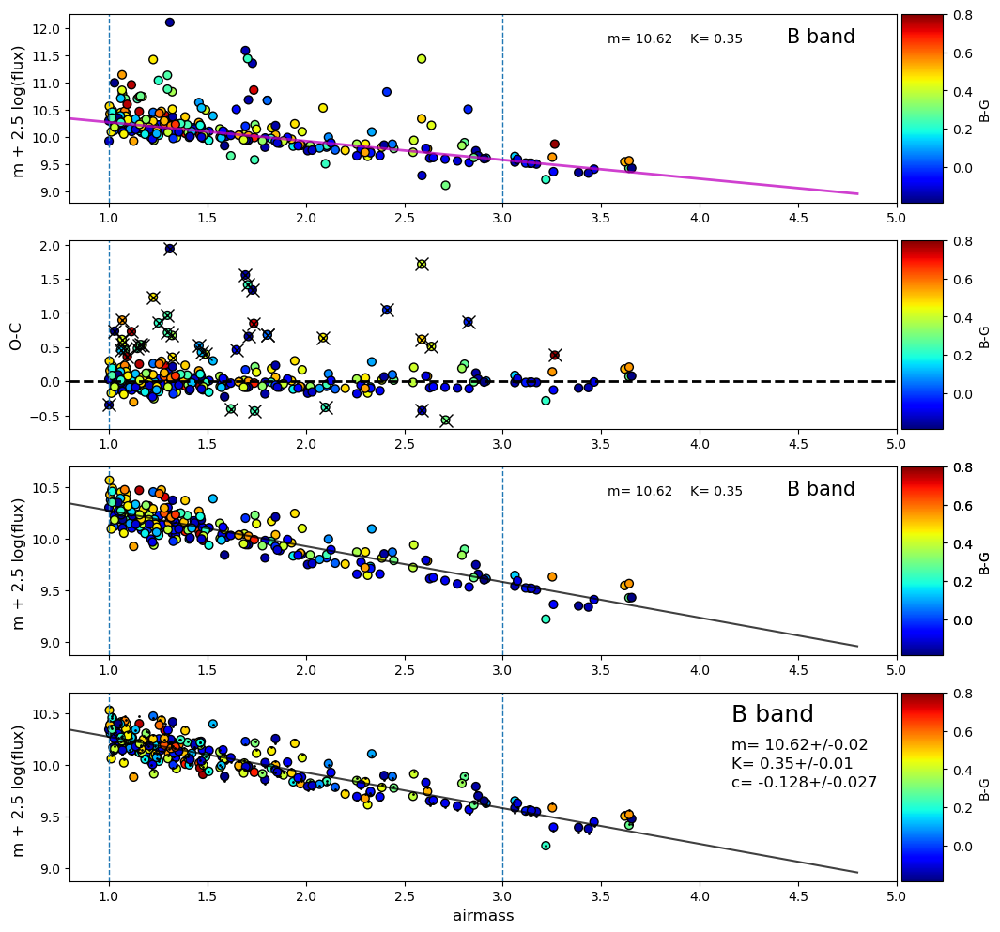

In [62]:
# Testing color term Bouger fit
x = t_rgb['secz']                                   # airmass
y = t_rgb['standard_B'] + 2.5 * np.log10(t_rgb['Fbs'])    # m + 2.5 log(flux)
z = t_rgb['standard_B'] - t_rgb['standard_G']   # B-G color index
#z = t_rgb['standard_B'] - t_rgb['standard_R']   # B-R color index

xx , yy ,zz = [],[],[]
for i in range(len(x)):
    if  y[i] > 0:
#    if np.isnan(y[i]) == False:
        xx.append(x[i])
        yy.append(y[i])
        zz.append(z[i])
        
bouguer_b, color_b = phot_fit_color_term(xx,yy,zz,label='B band')
print(bouguer_b.params)
print(color_b.params)
plt.savefig('fig_B_SEP.png')

Fitting Bouguer extinction law

Iteration #0
Number of points in fit..: 278
Number of points rejected: 0
Fit result: m0=9.83, k=0.27

Iteration #1
Number of points in fit..: 239
Number of points rejected: 39
Fit result: m0=9.73, k=0.25

Iteration #2
Number of points in fit..: 246
Number of points rejected: 32
Fit result: m0=9.72, k=0.26

Iteration #3
Number of points in fit..: 248
Number of points rejected: 30
Fit result: m0=9.72, k=0.26

Parameters([('m0', <Parameter 'm0', value=9.718332389960104 +/- 0.0243, bounds=[-inf:inf]>), ('k', <Parameter 'k', value=0.257891266313066 +/- 0.0135, bounds=[-inf:inf]>)])
Parameters([('a', <Parameter 'a', value=-0.010050404665761964 +/- 0.0114, bounds=[-inf:inf]>), ('c', <Parameter 'c', value=0.047166247772632564 +/- 0.0325, bounds=[-inf:inf]>)])


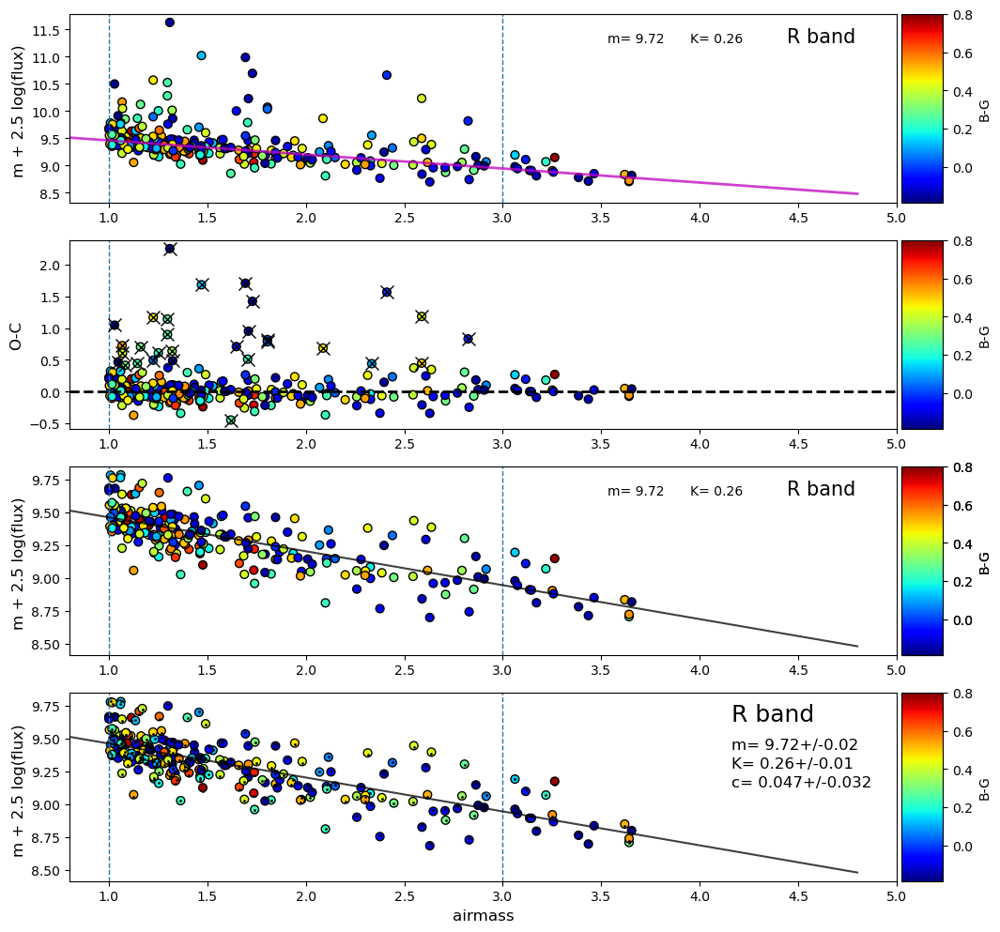

In [63]:
# Testing color term Bouger fit
x = t_rgb['secz']                                   # airmass
y = t_rgb['standard_R'] + 2.5 * np.log10(t_rgb['Frs'])    # m + 2.5 log(flux)
z = t_rgb['standard_B'] - t_rgb['standard_G']   # B-G color index
#z = t_rgb['standard_B'] - t_rgb['standard_R']   # B-R color index

xx , yy ,zz = [],[],[]
for i in range(len(x)):
    if  y[i] > 0:
#    if np.isnan(y[i]) == False:
        xx.append(x[i])
        yy.append(y[i])
        zz.append(z[i])
        
bouguer_r, color_r = phot_fit_color_term(xx,yy,zz,label='R band')
print(bouguer_r.params)
print(color_r.params)
plt.savefig('fig_R_SEP.png')

In [64]:
print(bouguer_b.params)
print(color_b.params)
print(bouguer_g.params)
print(color_g.params)
print(bouguer_r.params)
print(color_r.params)


Parameters([('m0', <Parameter 'm0', value=10.617377050038991 +/- 0.0207, bounds=[-inf:inf]>), ('k', <Parameter 'k', value=0.3456665420033075 +/- 0.0115, bounds=[-inf:inf]>)])
Parameters([('a', <Parameter 'a', value=0.025064086964703223 +/- 0.00907, bounds=[-inf:inf]>), ('c', <Parameter 'c', value=-0.12758437890880536 +/- 0.0269, bounds=[-inf:inf]>)])
Parameters([('m0', <Parameter 'm0', value=10.80309458927786 +/- 0.0232, bounds=[-inf:inf]>), ('k', <Parameter 'k', value=0.2836727038426303 +/- 0.0128, bounds=[-inf:inf]>)])
Parameters([('a', <Parameter 'a', value=-0.001968945785879566 +/- 0.0107, bounds=[-inf:inf]>), ('c', <Parameter 'c', value=0.009754966839770313 +/- 0.0313, bounds=[-inf:inf]>)])
Parameters([('m0', <Parameter 'm0', value=9.718332389960104 +/- 0.0243, bounds=[-inf:inf]>), ('k', <Parameter 'k', value=0.257891266313066 +/- 0.0135, bounds=[-inf:inf]>)])
Parameters([('a', <Parameter 'a', value=-0.010050404665761964 +/- 0.0114, bounds=[-inf:inf]>), ('c', <Parameter 'c', value

In [65]:
B0 = round(bouguer_b.params['m0'].value,2)
kB = round(bouguer_b.params['k'].value,2)
cB = round(color_b.params['c'].value,3)
B0_std = round(bouguer_b.params['m0'].stderr,2)
kB_std  = round(bouguer_b.params['k'].stderr,2)
cB_std  = round(color_b.params['c'].stderr,3)
print('B',B0,'+/-',B0_std,'  ',kB,'+/-',kB_std,'  ',cB,'+/-',cB_std)
G0     = round(bouguer_g.params['m0'].value,2)
kG     = round(bouguer_g.params['k'].value,2)
cG = round(color_g.params['c'].value,3)
G0_std = round(bouguer_g.params['m0'].stderr,2)
kG_std = round(bouguer_g.params['k'].stderr,2)
cG_std  = round(color_g.params['c'].stderr,3)
print('G',G0,'+/-',G0_std,'  ',kG,'+/-',kG_std,'  ',cG,'+/-',cG_std)
R0     = round(bouguer_r.params['m0'].value,2)
kR     = round(bouguer_r.params['k'].value,2)
cR = round(color_r.params['c'].value,3)
R0_std = round(bouguer_r.params['m0'].stderr,2)
kR_std = round(bouguer_r.params['k'].stderr,2)
cR_std  = round(color_r.params['c'].stderr,3)
print('R',R0,'+/-',R0_std,'  ',kR,'+/-',kR_std,'  ',cR,'+/-',cR_std)


B 10.62 +/- 0.02    0.35 +/- 0.01    -0.128 +/- 0.027
G 10.8 +/- 0.02    0.28 +/- 0.01    0.01 +/- 0.031
R 9.72 +/- 0.02    0.26 +/- 0.01    0.047 +/- 0.032
